##  Contexto: desigualdad y factores de éxito en pruebas Saber 11 en Colombia

El ICFES es el Instituto Colombiano para el Fomento de la Educación Superior y está adscrito al Ministerio de Educación a nivel nacional. Como parte de sus funciones, el ICFES administra las pruebas Saber 11, las cuales evalúan a todos los estudiantes del país al final de su educación secundaria. El examen contiene preguntas que evalúan una variedad de áreas del conocimiento (ej., matemáticas, física, inglés, etc.) y se lleva a cabo dos veces al año, ajustándose a los diferentes calendarios académicos que siguen las instituciones educativas. Al momento de inscribirse a las pruebas, los estudiantes diligencian un formulario que recoge información sociodemográfica y relacionada con la institución a la que pertenecen. El fin es obtener información con respecto al desempeño de los estudiantes en la prueba y de sus características.

![logo](Gráficas/logo-prueba-2022_saberpro.png)

Al igual que otros países de la región, Colombia tiene grandes retos en términos de desigualdad, particularmente en el contexto de educación primaria y secundaria. Por esta razón, para el Estado colombiano es muy valioso el amplio registro de datos que el ICFES genera alrededor de las pruebas Saber 11, pues con ellos se pueden generar análisis sobre la calidad de la educación en el país y eventualmente dar lugar a recomendaciones sobre políticas públicas. En particular, la problemática a abordar en este caso de estudio es la desigualdad y factores de éxito en las pruebas Saber 11. 

Los objetivos de este caso de estudio son:

* Entender el contenido de los archivos de datos proporcionados sobre las pruebas Saber 11, generar un reporte acerca de sus características principales y seleccionar las partes de dicho contenido que podrían ser relevantes para el análisis.


* Identificar características de las variables de interés y relaciones entre ellas, por ejemplo, a través de agrupación, visualizaciones y estadísticas descriptivas.


* Proponer un modelo que busque relacionar las variables de interés con el desempeño de los estudiantes y concluir acerca de los posibles hallazgos que se podrían reportar para el *stakeholder*.


* Generar una herramienta que permita a un usuario interactuar con alguno de los parámetros del análisis realizado de forma relevante en el contexto del problema.

## Fase 1: obtener e inspeccionar archivos

En esta fase te harás una idea general del contenido de los datos y generarás un reporte al respecto (ej., imprimiendo mensajes, presentando tablas de resumen, etc.). Además, seleccionarás un segmento de los datos que consideres útil para realizar tu análisis.

Preguntas guía:

* ¿Qué dimensiones tienen los datos?
* ¿Con cuántos años y periodos de evaluación se cuenta?
* ¿Cuáles variables pueden ser de interés para la problemática planteada?
* ¿Qué porcentaje de datos faltantes o no válidos hay en las columnas de interés? ¿Qué planteas para manejarlos?

### Dimensiones de los Datos

In [1]:
#importamos las librerias necesarias para cargar los datos
import pandas            as pd
import numpy             as np
import seaborn           as sns
import matplotlib.pyplot as plt
import pingouin          as pg
import missingno         as msno

from collections import Counter
from datetime import datetime
from scipy import stats
from scipy.stats import chi2_contingency

import statsmodels.api as sm
import statsmodels.formula.api as smf

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression, LinearRegression, Ridge, Lasso, SGDRegressor 
from sklearn.metrics import accuracy_score, plot_confusion_matrix, confusion_matrix, classification_report, precision_score, recall_score, f1_score,r2_score, explained_variance_score,mean_absolute_error
from sklearn.impute import SimpleImputer

import warnings
warnings.filterwarnings('ignore')

C:\Users\Juan Fernando\anaconda3\lib\site-packages\outdated\utils.py:14: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.1, the latest is 0.2.2.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


In [2]:
#creamos una lista con los nombres de los archivos
lista_bases = ['SB11_20201','SB11_20202','SB11_20211','SB11_20212']

#creamos una función para cargar en un diccionario los dataframes de 2020 a 2021
def lectura_bases(lista_bases):
    datos={}
    for base in lista_bases:
        lectura = "Datos\{}.txt".format(base)
        datos[base] = pd.read_csv(lectura,sep="¬",engine='python') 
    return datos

datos = lectura_bases(lista_bases)

#evaluamos la cantidad de registros y columnas de los dataframes:
for base in lista_bases:
    print("Datos en la base {0}:{1} // columnas: {2}".format(base,len(datos[base]),len(datos[base].columns)))

Datos en la base SB11_20201:15435 // columnas: 81
Datos en la base SB11_20202:504872 // columnas: 81
Datos en la base SB11_20211:15528 // columnas: 78
Datos en la base SB11_20212:532979 // columnas: 82


Para la data de 2020 y 2021 podemos ver con este primer cargue que no son iguales la cantidad de estudiantes que presentan las pruebas en calendario A y B (sinembargo conserva una similar proporción entre calendarios), y adicionalmente que los periodos evaluados no contienen la misma cantidad de variables descriptivas (columnas).

In [3]:
#creamos una función para evaluar qué columnas no se tienen en comun entre los dataframes 
def validacion_columnas(lista):
    #creamos un diccionario para organizar los dataframes de mayor a menor cantidad de columnas
    dic ={}
    for elemento in lista:
        dic[elemento] = len(list(datos[elemento].columns))
    ordenados = sorted(dic.items(), key=lambda x: x[1], reverse=True)
    ordenados_dict = dict(ordenados)
    listado = list(ordenados_dict.keys())
    # creamos otro ciclo para evaluar los elementos que no se encuentran en común entre los dataframes
    todos = []
    dif=[]
    for base in listado:
        columnas= list(datos[base].columns)
        for elemento in columnas:
            if elemento not in todos:
                todos.append(elemento)
        for elemento in todos:
            if elemento not in columnas and elemento not in dif:
                dif.append(elemento)   
    return dif

# creamos una función para consolidar un solo dataframe de los años 2020 y 2021 con las columnas en común
def consolidar_df():
    eliminar = validacion_columnas(lista_bases)
    dic = {}
    for base in lista_bases:
        data = datos[base]
        for elemento in eliminar:
            try:
                data = data.drop(elemento,axis=1)
            except KeyError:
                pass
        dic[base] = data
    return pd.concat(dic.values(), ignore_index=True)
consolidado = consolidar_df()

'El dataframe resultante tiene unas dimensiones de {0} filas y {1} columnas'.format(consolidado.shape[0],consolidado.shape[1])

'El dataframe resultante tiene unas dimensiones de 1068814 filas y 77 columnas'

In [4]:
consolidado.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1068814 entries, 0 to 1068813
Data columns (total 77 columns):
 #   Column                         Non-Null Count    Dtype  
---  ------                         --------------    -----  
 0   ESTU_TIPODOCUMENTO             1068814 non-null  object 
 1   ESTU_NACIONALIDAD              1068814 non-null  object 
 2   ESTU_GENERO                    1068708 non-null  object 
 3   ESTU_FECHANACIMIENTO           1068814 non-null  object 
 4   PERIODO                        1068814 non-null  int64  
 5   ESTU_CONSECUTIVO               1068814 non-null  object 
 6   ESTU_ESTUDIANTE                1068814 non-null  object 
 7   ESTU_PAIS_RESIDE               1068814 non-null  object 
 8   ESTU_TIENEETNIA                1062610 non-null  object 
 9   ESTU_DEPTO_RESIDE              1067963 non-null  object 
 10  ESTU_COD_RESIDE_DEPTO          1067963 non-null  float64
 11  ESTU_MCPIO_RESIDE              1067963 non-null  object 
 12  ESTU_COD_RESID

Evaluando las caracteristicas de la información contenida, definmos desechar las siguientes ya sea por ser un id de un código o no aportar información relevante: 

In [5]:
eliminar=['ESTU_CONSECUTIVO','ESTU_ESTUDIANTE','ESTU_COD_RESIDE_DEPTO','ESTU_COD_RESIDE_MCPIO','COLE_CODIGO_ICFES',
          'COLE_COD_DANE_ESTABLECIMIENTO','COLE_COD_DANE_SEDE','COLE_COD_MCPIO_UBICACION','COLE_MCPIO_UBICACION',
          'COLE_COD_DEPTO_UBICACION','COLE_DEPTO_UBICACION','ESTU_COD_MCPIO_PRESENTACION','ESTU_COD_DEPTO_PRESENTACION',
          'PERCENTIL_LECTURA_CRITICA','DESEMP_LECTURA_CRITICA','PERCENTIL_MATEMATICAS','DESEMP_MATEMATICAS',
          'PERCENTIL_C_NATURALES','DESEMP_C_NATURALES','PERCENTIL_SOCIALES_CIUDADANAS','DESEMP_SOCIALES_CIUDADANAS',
          'PERCENTIL_INGLES','DESEMP_INGLES','PERCENTIL_GLOBAL','ESTU_ESTADOINVESTIGACION','ESTU_TIPODOCUMENTO',
          'ESTU_MCPIO_PRESENTACION','ESTU_DEPTO_PRESENTACION','ESTU_TIPOREMUNERACION']
consolidado = consolidado.drop(eliminar,axis=1)
'El dataframe resultante tiene unas dimensiones de {0} filas y {1} columnas'.format(consolidado.shape[0],consolidado.shape[1])

'El dataframe resultante tiene unas dimensiones de 1068814 filas y 48 columnas'

### Evaluación de Faltantes

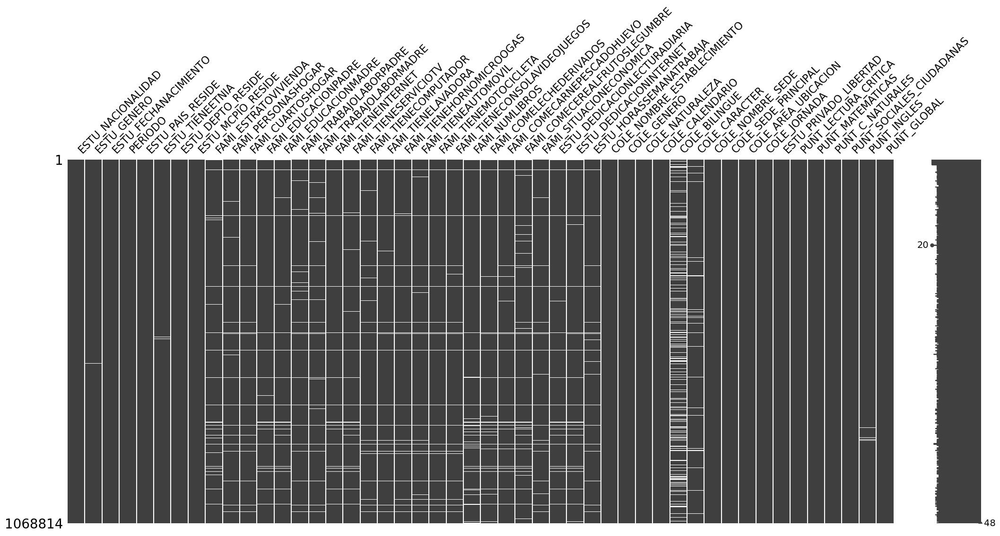

In [6]:
msno.matrix(consolidado);

In [7]:
# % de filas del dataframe con vales NaN
print("Porcentaje de filas del DF con al menos 1 valor Nan:{: .1%}".format((consolidado.shape[0] - consolidado.dropna().shape[0])/ consolidado.shape[0]))
print("Porcentaje de filas del DF con mas de 2 valores Nan:{: .1%}".format(len(consolidado[consolidado.isnull().sum(axis=1) >= 2])/ len(consolidado)))

Porcentaje de filas del DF con al menos 1 valor Nan: 28.1%
Porcentaje de filas del DF con mas de 2 valores Nan: 10.4%


eliminaremos las filas con mas de 1 dato faltante, correspondeinte al 10,5% del dataset

In [8]:
consolidado = consolidado[consolidado.isna().sum(axis=1) < 2]
consolidado.shape

(957988, 48)

In [9]:
# creamos una función para evaluar el porcentaje de nulos restantes por columna
nulos = {}
for i in consolidado.columns:
    dato = round(consolidado[i].isna().sum()/len(consolidado[i]),3)
    if dato > 0:
        nulos[i] = "{: .1%}".format(round(consolidado[i].isna().sum()/len(consolidado[i]),3))
nulos

{'ESTU_TIENEETNIA': ' 0.3%',
 'FAMI_ESTRATOVIVIENDA': ' 0.5%',
 'FAMI_PERSONASHOGAR': ' 0.1%',
 'FAMI_CUARTOSHOGAR': ' 0.2%',
 'FAMI_EDUCACIONPADRE': ' 0.1%',
 'FAMI_EDUCACIONMADRE': ' 0.1%',
 'FAMI_TRABAJOLABORPADRE': ' 0.5%',
 'FAMI_TRABAJOLABORMADRE': ' 0.2%',
 'FAMI_TIENEINTERNET': ' 0.1%',
 'FAMI_TIENESERVICIOTV': ' 0.2%',
 'FAMI_TIENECOMPUTADOR': ' 0.4%',
 'FAMI_TIENELAVADORA': ' 0.1%',
 'FAMI_TIENEHORNOMICROOGAS': ' 0.1%',
 'FAMI_TIENEAUTOMOVIL': ' 0.2%',
 'FAMI_TIENEMOTOCICLETA': ' 0.1%',
 'FAMI_TIENECONSOLAVIDEOJUEGOS': ' 0.1%',
 'FAMI_NUMLIBROS': ' 1.3%',
 'FAMI_COMELECHEDERIVADOS': ' 0.4%',
 'FAMI_COMECARNEPESCADOHUEVO': ' 0.1%',
 'FAMI_COMECEREALFRUTOSLEGUMBRE': ' 0.5%',
 'FAMI_SITUACIONECONOMICA': ' 0.2%',
 'ESTU_DEDICACIONLECTURADIARIA': ' 0.1%',
 'ESTU_DEDICACIONINTERNET': ' 0.2%',
 'ESTU_HORASSEMANATRABAJA': ' 0.2%',
 'COLE_BILINGUE': ' 13.1%',
 'COLE_CARACTER': ' 0.1%',
 'PUNT_INGLES': ' 0.2%'}

Como resultado del cargue e inspección inical de nuestro dataframe, consideramos evaluar inicalmente las 49 columnas  resultantes. Con respecto a los datos faltantes, vemos que estos estan concentrados en las variables descriptivas sociodemográficas del estudiante, sinembargo están por debajo del 5% del total de datos faltantes. 

No obstante, sí existe una variable de interes con un valor de faltantes relativamente alto y es la clasificación del colegio como Bilingue (13%). Para esta variable proponemos evaluar si la media de los resutlados en ingles de los colegios bilingues es diferente a la de los colegios no bilingues para construir un modelo de ML que nos permita completar los datos faltantes.

### Imputación de Faltantes

#### 'PUNT_INGLES'

In [10]:
# Considerando que los puntajes faltantes son apenas el 0.2% del total de datos, 
# les pondremos puntaje 0 o como si no se hubiera presentado la prueba
consolidado['PUNT_INGLES'] = consolidado['PUNT_INGLES'].fillna(0)

#### 'COLE_BILINGUE'

In [11]:
# Evaluamos si existe mas de una clasificación por colegio
revision = consolidado.groupby(['COLE_NOMBRE_ESTABLECIMIENTO','COLE_BILINGUE'])['ESTU_GENERO'].count().to_frame().reset_index()
prueba = revision.drop('ESTU_GENERO',axis=1)
prueba = prueba.groupby('COLE_NOMBRE_ESTABLECIMIENTO').count().reset_index().sort_values('COLE_BILINGUE',ascending=False)
prueba = prueba[prueba['COLE_BILINGUE']>1]['COLE_NOMBRE_ESTABLECIMIENTO']
revision = revision[revision['COLE_NOMBRE_ESTABLECIMIENTO'].isin(prueba)].pivot(index='COLE_NOMBRE_ESTABLECIMIENTO',columns='COLE_BILINGUE',values='ESTU_GENERO').reset_index()
revision['validacion'] = revision.apply(lambda x: 'S' if x.S > x.N else 'N',axis=1)
revision

COLE_BILINGUE,COLE_NOMBRE_ESTABLECIMIENTO,N,S,validacion
0,COL ABRAHAM LINCOLN,22,175,S
1,COLEGIO CHAMPAGNAT,125,51,N
2,COLEGIO SANTA MARIA,51,162,S
3,I.E. NORMAL SUPERIOR,40,59,S
4,I.E. PIO XII,105,319,S
5,I.E. SANTA TERESA,27,263,S
6,INSTITUCION EDUCATIVA DEPARTAMENTAL PIO XII,84,72,N
7,INSTITUCION EDUCATIVA LA UNION,216,47,N
8,INSTITUCION EDUCATIVA MARIA AUXILIADORA,939,34,N
9,INSTITUTO ESTUDIANTIL REGIONAL INTER,75,59,N


Encontramos que el listado de colegios anteriores tiene ambas clasificaciones. usaremos la mas común

In [12]:
for i in list(revision['COLE_NOMBRE_ESTABLECIMIENTO'].unique()):
    consolidado.loc[consolidado['COLE_NOMBRE_ESTABLECIMIENTO'] == i, 'COLE_BILINGUE'] = list(revision[revision['COLE_NOMBRE_ESTABLECIMIENTO'] == i]['validacion'])[0]

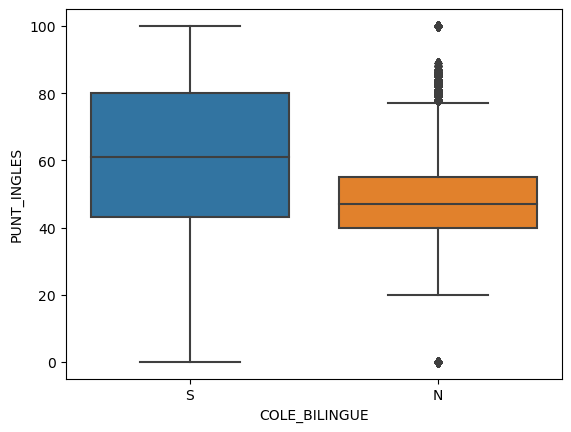

In [13]:
# creamos gráfica para visualizar el desempeño en ingles entre los colegios que son y no son bilingues
sns.boxplot(data=consolidado, x='COLE_BILINGUE', y='PUNT_INGLES');

In [14]:
# evaluamos si existe diferencia entre las medias de las poblaciones entre colegios que son y no son bilingues
ingles = consolidado[consolidado['COLE_BILINGUE'].notna()]
Bilingue = list(ingles[ingles['COLE_BILINGUE']=='S']['PUNT_INGLES'])
No_bilingue = list(ingles[ingles['COLE_BILINGUE']=='N']['PUNT_INGLES'])
pg.ttest(Bilingue, No_bilingue)

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,78.083956,16655.795111,two-sided,0.0,"[12.77, 13.42]",1.026427,inf,1.0


Con un p valor menor a un alpha=0.05 podemos decir que si existe una diferencia entre las medias de las poblaciones de estudiantes de colegio Bilingue y No Bilingue 

In [15]:
# dividimnos la información entre train y test (siendo estos los NA), agrupando por la media del puntaje de ingles de cada colegio
promedios = ingles.groupby(['COLE_NOMBRE_ESTABLECIMIENTO','COLE_BILINGUE'])['PUNT_INGLES'].mean().to_frame().reset_index()
predecir = consolidado[consolidado['COLE_BILINGUE'].isna()].groupby('COLE_NOMBRE_ESTABLECIMIENTO')['PUNT_INGLES'].mean().to_frame().reset_index()

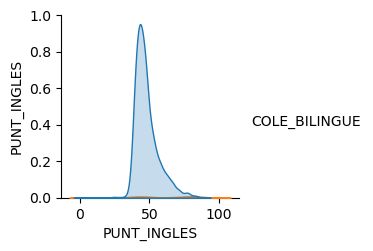

In [16]:
sns.pairplot(promedios, hue='COLE_BILINGUE');

Podemos observar que las clases están muy desbalanceadas entre colegios Bilingues y no Bilingues

In [17]:
# dividimos nuestra data de interes para entrenar el modelo
X = promedios['PUNT_INGLES'].values.reshape(-1, 1)
y = promedios['COLE_BILINGUE'].values.reshape(-1, 1)

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.40, random_state = 42)

# creamos un modelo de logistic regression para completar el dato de Colegio Bilingue basados en los resultados en ingles
# como observamos que las clases están super desbalanceadas, penalizaremos un segundo modelo
modelos = [LogisticRegression(),
           LogisticRegression(C=1.0,penalty='l2',random_state=1,solver="newton-cg",class_weight="balanced")]

for modelo in modelos:
    modelo.fit(X_train, y_train)

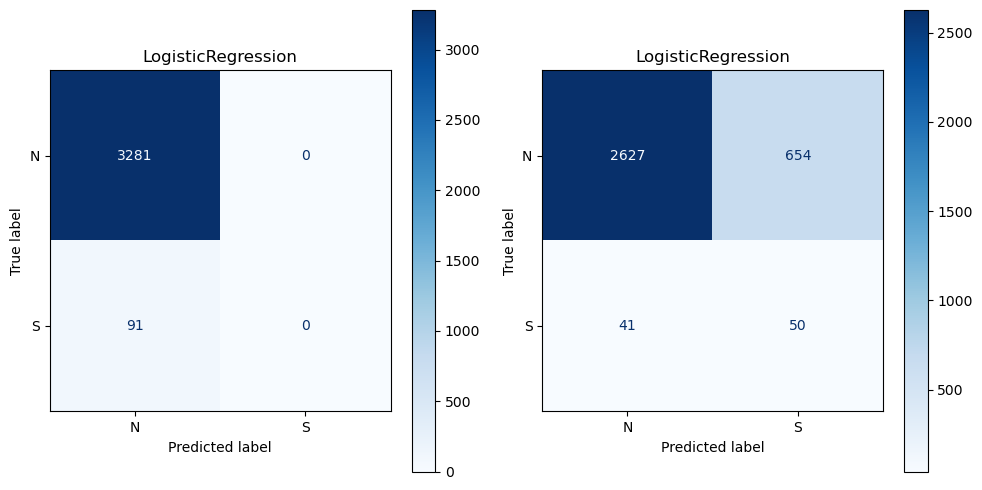

In [18]:
# visualizamos a través de una matriz de confución la bondad del modelo
fig, axes = plt.subplots(1, 2, figsize=(10,5))
for modelo, ax in zip(modelos, axes.flatten()):
    plot_confusion_matrix(modelo, X_test, y_test, ax=ax, cmap='Blues',)
    ax.title.set_text(type(modelo).__name__)
plt.tight_layout()  
plt.show()

Podemos observar que un modelo con mayores penalizaciones captura mejor los datos para la categoría 'S', que al estar desbalanceada se pierde en el primer modelo

In [19]:
# realizamos la predicción sobre los datos faltantes
predecir['COLE_BILINGUE'] = modelos[1].predict(predecir['PUNT_INGLES'].values.reshape(-1, 1),)
# consolidamos el dataset colegios
colegios = pd.merge(promedios, predecir, how='outer').drop('PUNT_INGLES',axis=1).drop_duplicates()

In [20]:
# validamos que efectivamente todo colegio tenga 1 sola clasificación despues de correr el modelo
rev = colegios.groupby(['COLE_NOMBRE_ESTABLECIMIENTO','COLE_BILINGUE']).size().sort_values(ascending=False).reset_index()
rev = rev.pivot(index='COLE_NOMBRE_ESTABLECIMIENTO',columns='COLE_BILINGUE',values=0).reset_index().fillna(0)
rev['val']= rev['N']+rev['S']
rev =rev[rev['val']>1]
rev

COLE_BILINGUE,COLE_NOMBRE_ESTABLECIMIENTO,N,S,val
423,CIBERCOLEGIO UCN,1.0,1.0,2.0
500,COL ALMIRANTE COLON DE MONTERIA,1.0,1.0,2.0
502,COL AMERICANO,1.0,1.0,2.0
534,COL BETHLEMITAS,1.0,1.0,2.0
868,COL LA ANUNCIACION,1.0,1.0,2.0
1041,COL PARROQ SAN LUIS GONZAGA,1.0,1.0,2.0
1377,COLEGIO AGUSTIN NIETO CABALLERO,1.0,1.0,2.0
1553,COLEGIO CAMPESTRE SAN DIEGO,1.0,1.0,2.0
2448,COLEGIO RAFAEL POMBO,1.0,1.0,2.0
2500,COLEGIO SAN ALBERTO MAGNO,1.0,1.0,2.0


Para el listado de colegios anteriores el modelo los clasifica como bilingues por el promedio de los estudiantes, por lo que para efectos del ejercicio los clasificaremos como "S" o Bilingues

In [21]:
listado = list(rev['COLE_NOMBRE_ESTABLECIMIENTO'].unique())
drop = colegios[(colegios['COLE_NOMBRE_ESTABLECIMIENTO'].isin(listado)) & (colegios['COLE_BILINGUE'] == 'N')].index
colegios.drop(drop,inplace=True)

In [22]:
# creamos el merge con el dataset original para reemplazar los NA en colegio bilingue
consolidado = pd.merge(consolidado, colegios, how='left',on='COLE_NOMBRE_ESTABLECIMIENTO',copy=False).drop('COLE_BILINGUE_x',axis=1)
consolidado = consolidado.rename(columns={'COLE_BILINGUE_y':'COLE_BILINGUE'})

#### Resto de Variables

In [23]:
# creamos un listado de las variables a imputar. Todas estas estan por debajo del 5% de los datos. 
# Puntaje en ingles y si el Colegio es bilingue vamos a retirarlas porque ya se trataron por aparte
evaluar=[]
for i in nulos.keys():
    if nulos[i] != ' 0.0%':
        evaluar.append(i)
no_inc = ['COLE_BILINGUE','PUNT_INGLES']
for i in no_inc:
    evaluar.remove(i)

In [24]:
# traemos de sklearn el modelo para imputar datos faltantes para datos categoricos, reemplazando por la moda de cada columna
# Construimos el modelo para datos categóricos o numéricos
imputerCat = SimpleImputer(missing_values=np.nan, strategy='most_frequent')

# creamos un ciclo para recorrer las variables a imputar
for i in  consolidado:
    data = np.array(consolidado[i].values.reshape(-1, 1))
    consolidado[i] = imputerCat.fit_transform(data)

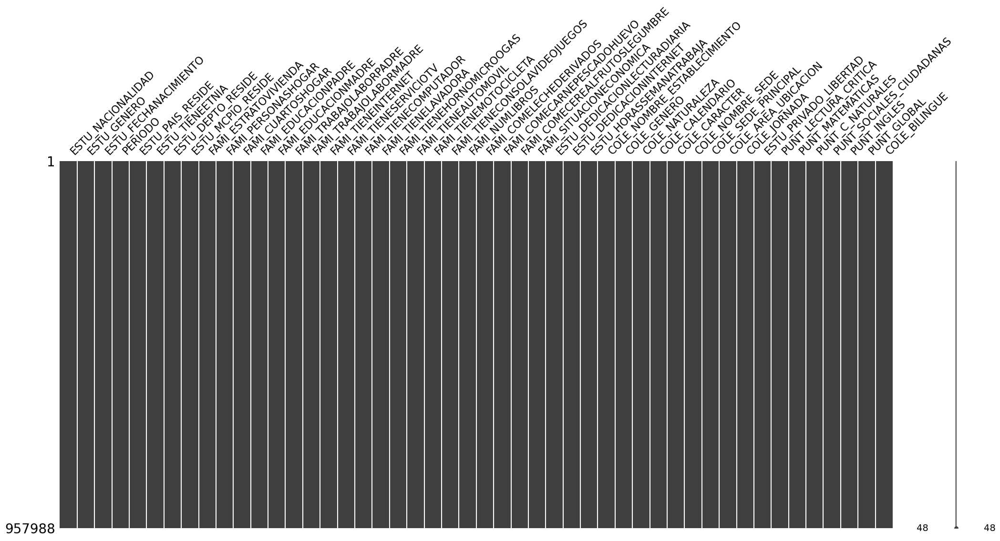

In [25]:
msno.matrix(consolidado);

### Aumento de Datos / Agrupación de Datos

#### Edad del estudiante

evaluando las variables de interes vemos que no tenemos la edad pero si la fecha de nacimiento y de presentación del examen, por lo que calcularemos la edad al momento de presentar el examen

In [26]:
# reemplazamos los datos tipo int a string de fechas para convertir a Date Time
consolidado['PERIODO'] = consolidado['PERIODO'].replace([20201, 20204, 20211, 20214],['01/02/2020','01/11/2020','01/02/2021','01/11/2021'])

In [27]:
revision = consolidado.groupby('ESTU_FECHANACIMIENTO')['ESTU_GENERO'].count().to_frame().reset_index()
revision['año'] = revision['ESTU_FECHANACIMIENTO'].apply(lambda x: str(x)[-4:])
revision = revision.sort_values('año',ascending=True)
revision2 = revision.groupby('año')['ESTU_FECHANACIMIENTO'].count()

In [28]:
revision2.head(15)

año
0001    268
0002    356
0003    363
0004    316
0005     67
0006      5
0007      2
0008      1
0009      1
0011      1
0099      1
1900      1
1905      1
1941      1
1942      1
Name: ESTU_FECHANACIMIENTO, dtype: int64

In [29]:
revision2.tail(10)

año
2012    57
2013    48
2014    19
2015    17
2016     3
2017     1
2018     5
2019     2
2020    60
2021    23
Name: ESTU_FECHANACIMIENTO, dtype: int64

In [30]:
# reemplazamos los valores que no son lógicos por estimaciones de fechas
consolidado['año'] = consolidado['ESTU_FECHANACIMIENTO'].apply(lambda x: str(x)[-4:]).astype(int)
quitar_años = consolidado[(consolidado['año']<1940)|(consolidado['año']>2006)].index
consolidado.drop(quitar_años,inplace=True)

In [31]:
# pasamos a tipo date time las fechas de nacimiento y los periodos de presentación del examen para calcular la edad
consolidado['ESTU_FECHANACIMIENTO'] = consolidado['ESTU_FECHANACIMIENTO'].apply(lambda x:datetime.strptime(x, '%d/%m/%Y'))
consolidado['PERIODO'] =consolidado['PERIODO'].apply(lambda x:datetime.strptime(x, '%d/%m/%Y'))

In [32]:
# Calculamos la edad de los estudiantes al momento de presentar el examen
consolidado['EDAD_EXAMEN'] = round((consolidado['PERIODO'] - consolidado['ESTU_FECHANACIMIENTO']).dt.days / 365, 0)
consolidado.drop('año',inplace=True,axis=1)

#### Región Geográfica

In [33]:
# creamos listado de departamentos por regiones según DANE:
AMAZONIA = ['AMAZONAS', 'CAQUETA', 'PUTUMAYO', 'GUAINIA', 'GUAVIARE', 'VAUPES']
ORINOQUIA = ['META', 'ARAUCA', 'CASANARE', 'VICHADA']
ANDINA = ['ANTIOQUIA', 'BOYACA','BOGOTÁ', 'CALDAS', 'CUNDINAMARCA', 'HUILA', 'NORTE SANTANDER', 'QUINDIO', 'RISARALDA', 'SANTANDER', 'TOLIMA']
CARIBE = ['ATLANTICO', 'BOLIVAR', 'CESAR', 'CORDOBA', 'LA GUAJIRA', 'MAGDALENA', 'SUCRE', 'SAN ANDRES','Providencia y Santa Catalina']
PACIFICA = ['CAUCA', 'VALLE', 'CHOCO', 'NARIÑO']

# creamos variable de region del estudiante 
consolidado['REGION'] = consolidado['ESTU_DEPTO_RESIDE'].apply(lambda x: 
                                            'AMAZONIA' if x in AMAZONIA else
                                            'ORINOQUIA' if x in ORINOQUIA else
                                            'ANDINA' if x in ANDINA else
                                            'CARIBE' if x in CARIBE else
                                            'PACIFICA' if x in PACIFICA else
                                            'OTRA')

#### Educación Padres

In [34]:
# evaluamos las posibles categorias de niveles de estudio para agruparlas 
educaciones = (list(consolidado['FAMI_EDUCACIONPADRE'].unique()) + list(consolidado['FAMI_EDUCACIONMADRE'].unique()))
listado_educ = []
for educ in educaciones:
    if educ not in listado_educ:
        listado_educ.append(educ)       
listado_educ.sort()
listado_educ

['Educación profesional completa',
 'Educación profesional incompleta',
 'Ninguno',
 'No Aplica',
 'No sabe',
 'Postgrado',
 'Primaria completa',
 'Primaria incompleta',
 'Secundaria (Bachillerato) completa',
 'Secundaria (Bachillerato) incompleta',
 'Técnica o tecnológica completa',
 'Técnica o tecnológica incompleta']

In [35]:
# agrupamos las categorias entre similares
consolidado['FAMI_EDUCACIONPADRE'] = consolidado['FAMI_EDUCACIONPADRE'].replace(['Educación profesional completa','Educación profesional incompleta','Ninguno','No Aplica','No sabe','Postgrado','Primaria completa','Primaria incompleta','Secundaria (Bachillerato) completa','Secundaria (Bachillerato) incompleta','Técnica o tecnológica completa','Técnica o tecnológica incompleta'],['Profesional','Profesional','Ninguno','No Aplica','No Aplica','Profesional','Primaria','Primaria','Bachillerato','Bachillerato','Técnica o tecnológica','Técnica o tecnológica'])
consolidado['FAMI_EDUCACIONMADRE'] = consolidado['FAMI_EDUCACIONMADRE'].replace(['Educación profesional completa','Educación profesional incompleta','Ninguno','No Aplica','No sabe','Postgrado','Primaria completa','Primaria incompleta','Secundaria (Bachillerato) completa','Secundaria (Bachillerato) incompleta','Técnica o tecnológica completa','Técnica o tecnológica incompleta'],['Profesional','Profesional','Ninguno','No Aplica','No Aplica','Profesional','Primaria','Primaria','Bachillerato','Bachillerato','Técnica o tecnológica','Técnica o tecnológica'])

In [36]:
# creamos un diccionario con niveles
mapper_estudio = {'No Aplica':0, 'Ninguno':0, 'Primaria':1,'Bachillerato':2,'Técnica o tecnológica':3,'Profesional':4}
# creamos el campo de edución max entre padre y madre
consolidado['FAMI_EDUCACIONMAX'] = consolidado.apply(lambda x: list(mapper_estudio.keys())[list(mapper_estudio.values()).index(max(mapper_estudio[x['FAMI_EDUCACIONPADRE']],mapper_estudio[x['FAMI_EDUCACIONMADRE']]))], axis=1)

#### Trabajo Padres

In [37]:
# evaluamos las posibles categorias de trabajo para agruparlas 
trabajos = (list(consolidado['FAMI_TRABAJOLABORPADRE'].unique()) + list(consolidado['FAMI_TRABAJOLABORMADRE'].unique()))
listado_trabajo = []
for trabajo in trabajos:
    if trabajo not in listado_trabajo:
        listado_trabajo.append(trabajo)
        
listado_trabajo.sort()
listado_trabajo

['Es agricultor, pesquero o jornalero',
 'Es dueño de un negocio grande, tiene un cargo de nivel directivo o gerencial',
 'Es dueño de un negocio pequeño (tiene pocos empleados o no tiene, por ejemplo tienda, papelería, etc',
 'Es operario de máquinas o conduce vehículos (taxita, chofer)',
 'Es vendedor o trabaja en atención al público',
 'No aplica',
 'No sabe',
 'Pensionado',
 'Tiene un trabajo de tipo auxiliar administrativo (por ejemplo, secretario o asistente)',
 'Trabaja como personal de limpieza, mantenimiento, seguridad o construcción',
 'Trabaja como profesional (por ejemplo médico, abogado, ingeniero)',
 'Trabaja en el hogar, no trabaja o estudia',
 'Trabaja por cuenta propia (por ejemplo plomero, electricista)']

In [38]:
# agrupamos las categorias entre similares
consolidado['FAMI_TRABAJOLABORPADRE'] = consolidado['FAMI_TRABAJOLABORPADRE'].replace(['Es agricultor, pesquero o jornalero','Es dueño de un negocio grande, tiene un cargo de nivel directivo o gerencial','Es dueño de un negocio pequeño (tiene pocos empleados o no tiene, por ejemplo tienda, papelería, etc','Es operario de máquinas o conduce vehículos (taxita, chofer)','Es vendedor o trabaja en atención al público','No aplica','No sabe','Pensionado','Tiene un trabajo de tipo auxiliar administrativo (por ejemplo, secretario o asistente)','Trabaja como personal de limpieza, mantenimiento, seguridad o construcción','Trabaja como profesional (por ejemplo médico, abogado, ingeniero)','Trabaja en el hogar, no trabaja o estudia','Trabaja por cuenta propia (por ejemplo plomero, electricista)'],['Campo','Empresario','Micro-Empresario','Empleado','Empleado','No aplica','No aplica','Pensionado','Empleado','Empleado','Profesional','Hogar','Independiente'])
consolidado['FAMI_TRABAJOLABORMADRE'] = consolidado['FAMI_TRABAJOLABORMADRE'].replace(['Es agricultor, pesquero o jornalero','Es dueño de un negocio grande, tiene un cargo de nivel directivo o gerencial','Es dueño de un negocio pequeño (tiene pocos empleados o no tiene, por ejemplo tienda, papelería, etc','Es operario de máquinas o conduce vehículos (taxita, chofer)','Es vendedor o trabaja en atención al público','No aplica','No sabe','Pensionado','Tiene un trabajo de tipo auxiliar administrativo (por ejemplo, secretario o asistente)','Trabaja como personal de limpieza, mantenimiento, seguridad o construcción','Trabaja como profesional (por ejemplo médico, abogado, ingeniero)','Trabaja en el hogar, no trabaja o estudia','Trabaja por cuenta propia (por ejemplo plomero, electricista)'],['Campo','Empresario','Micro-Empresario','Empleado','Empleado','No aplica','No aplica','Pensionado','Empleado','Empleado','Profesional','Hogar','Independiente'])

In [39]:
# creamos un diccionario con niveles
mapper_trabajo = {'No aplica':0, 'Hogar':1, 'Campo':2,'Empleado':3,'Pensionado':4,'Independiente':4,'Micro-Empresario':5,'Profesional':6,'Empresario':7}
# creamos el campo de edución max entre padre y madre
consolidado['FAMI_TRABAJOLABORMAX'] = consolidado.apply(lambda x: list(mapper_trabajo.keys())[list(mapper_trabajo.values()).index(max(mapper_trabajo[x['FAMI_TRABAJOLABORPADRE']],mapper_trabajo[x['FAMI_TRABAJOLABORMADRE']]))], axis=1)

#### Vehículos en el Hogar

In [40]:
# creamos una columna indicando si tienen vehículo o moto, o no
consolidado['FAMI_TIENEVEHICULO'] = consolidado.apply(lambda x: 'Si' if ( bool(x['FAMI_TIENEAUTOMOVIL']=='Si')| bool(x['FAMI_TIENEMOTOCICLETA']=='Si') ) else 'No',axis=1)

## Fase 2: identificar características y relaciones en las variables

En esta fase realizarás análisis descriptivo para identificar posibles patrones o relaciones entre las variables de interés para la problemática planteada. Además, expondrás estadísticas descriptivas y visualizaciones para concluir al respecto de los patrones y las relaciones identificadas. Finalmente, elegirás el segmento de los datos sobre el cual profundizarás con tu análisis (este puede ser, o no, igual al seleccionado anteriormente).

Preguntas guía:

* ¿Hay patrones de interés en las distribuciones de las variables o en las relaciones entre ellas?
* ¿Consideras que existe algún impacto significativo de variables sociodemográficas en los puntajes globales o por área?
* ¿Sobre cuáles variables harías un análisis más profundo?

**para nuestro análisis inicial exploraremos algunas variables socidemográficas de interes para describir nuestra población e ir evaluando estas mismas caracteristicas vs el desempeño en las pruebas**

In [41]:
sociodemo = ['ESTU_GENERO','FAMI_ESTRATOVIVIENDA','REGION', 'FAMI_EDUCACIONMAX','FAMI_TRABAJOLABORMAX','FAMI_SITUACIONECONOMICA',
             'FAMI_TIENECOMPUTADOR','FAMI_NUMLIBROS','FAMI_TIENESERVICIOTV','FAMI_TIENEINTERNET','FAMI_TIENEVEHICULO',
             'FAMI_TIENELAVADORA','FAMI_COMECARNEPESCADOHUEVO','FAMI_COMECEREALFRUTOSLEGUMBRE','ESTU_TIENEETNIA','ESTU_DEDICACIONLECTURADIARIA',
             'ESTU_DEDICACIONINTERNET','FAMI_TIENECONSOLAVIDEOJUEGOS','ESTU_HORASSEMANATRABAJA','COLE_NATURALEZA','COLE_CARACTER',
             'COLE_AREA_UBICACION','COLE_CALENDARIO','COLE_JORNADA','EDAD_EXAMEN']

In [42]:
# damos orden a las variables categoricas ordinales de interes:
consolidado['FAMI_ESTRATOVIVIENDA'] = pd.Categorical(consolidado['FAMI_ESTRATOVIVIENDA'],['Sin Estrato','Estrato 1','Estrato 2','Estrato 3','Estrato 4','Estrato 5','Estrato 6'],ordered=True)
consolidado['FAMI_EDUCACIONMAX'] = pd.Categorical(consolidado['FAMI_EDUCACIONMAX'],['No Aplica','Primaria','Bachillerato','Técnica o tecnológica','Profesional'],ordered=True)
consolidado['FAMI_TRABAJOLABORMAX'] = pd.Categorical(consolidado['FAMI_TRABAJOLABORMAX'],['Hogar','Campo','Empleado','Profesional','Micro-Empresario','Empresario','Pensionado'],ordered=True)
consolidado['FAMI_NUMLIBROS'] = pd.Categorical(consolidado['FAMI_NUMLIBROS'],['0 A 10 LIBROS', '11 A 25 LIBROS', '26 A 100 LIBROS','MÁS DE 100 LIBROS'],ordered=True)
consolidado['FAMI_COMECARNEPESCADOHUEVO'] = pd.Categorical(consolidado['FAMI_COMECARNEPESCADOHUEVO'],['Nunca o rara vez comemos eso','1 o 2 veces por semana','3 a 5 veces por semana','Todos o casi todos los días'],ordered=True)
consolidado['FAMI_COMECEREALFRUTOSLEGUMBRE'] = pd.Categorical(consolidado['FAMI_COMECEREALFRUTOSLEGUMBRE'],['Nunca o rara vez comemos eso','1 o 2 veces por semana','3 a 5 veces por semana','Todos o casi todos los días'],ordered=True)
consolidado['ESTU_DEDICACIONLECTURADIARIA'] = pd.Categorical(consolidado['ESTU_DEDICACIONLECTURADIARIA'],['No leo por entretenimiento','30 minutos o menos','Entre 30 y 60 minutos','Entre 1 y 2 horas','Más de 2 horas'],ordered=True)
consolidado['ESTU_DEDICACIONINTERNET'] = pd.Categorical(consolidado['ESTU_DEDICACIONINTERNET'],['No Navega Internet','30 minutos o menos','Entre 30 y 60 minutos','Entre 1 y 3 horas', 'Más de 3 horas'],ordered=True)
consolidado['ESTU_HORASSEMANATRABAJA'] = pd.Categorical(consolidado['ESTU_HORASSEMANATRABAJA'],['0','Menos de 10 horas','Entre 11 y 20 horas','Entre 21 y 30 horas','Más de 30 horas'],ordered=True)
consolidado['COLE_CARACTER'] = pd.Categorical(consolidado['COLE_CARACTER'],['NO APLICA','TÉCNICO','TÉCNICO/ACADÉMICO','ACADÉMICO'],ordered=True)
consolidado['COLE_JORNADA'] = pd.Categorical(consolidado['COLE_JORNADA'],['MAÑANA','TARDE','NOCHE', 'SABATINA', 'COMPLETA','UNICA'],ordered=True)
consolidado['FAMI_CUARTOSHOGAR'] = pd.Categorical(consolidado['FAMI_CUARTOSHOGAR'],['Uno','Dos','Tres','Cuatro','Cinco','Seis o mas'],ordered=True)
consolidado['FAMI_PERSONASHOGAR'] = pd.Categorical(consolidado['FAMI_PERSONASHOGAR'],['1 a 2', '3 a 4', '5 a 6', '7 a 8', '9 o más'],ordered=True)

### Gráficas Descriptivas de la Población

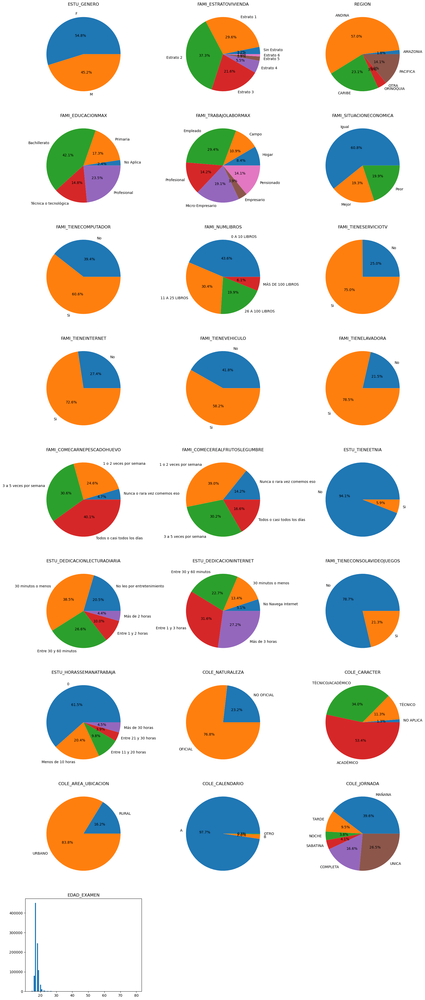

In [43]:
plt.figure(figsize=(20,50))
for i,var in enumerate(sociodemo):
    plt.subplot(9,3,i+1)
    if var in ['ESTU_GENERO','FAMI_ESTRATOVIVIENDA','REGION', 'FAMI_EDUCACIONMAX','FAMI_TRABAJOLABORMAX','FAMI_SITUACIONECONOMICA',
             'FAMI_TIENECOMPUTADOR','FAMI_NUMLIBROS','FAMI_TIENESERVICIOTV','FAMI_TIENEINTERNET','FAMI_TIENEVEHICULO',
             'FAMI_TIENELAVADORA','FAMI_COMECARNEPESCADOHUEVO','FAMI_COMECEREALFRUTOSLEGUMBRE','ESTU_TIENEETNIA','ESTU_DEDICACIONLECTURADIARIA',
             'ESTU_DEDICACIONINTERNET','FAMI_TIENECONSOLAVIDEOJUEGOS','ESTU_HORASSEMANATRABAJA','COLE_NATURALEZA','COLE_CARACTER',
             'COLE_AREA_UBICACION','COLE_CALENDARIO','COLE_JORNADA']:
        data = consolidado.groupby(var).size()
        labels = data.keys()
        plt.pie(x=data, autopct="%.1f%%", labels=labels, pctdistance=0.5)
        plt.title(("{}").format(var))    
    if var in ['EDAD_EXAMEN']:
        plt.hist(consolidado[var],bins=100)
        plt.title(("{}").format(var))  
fig.tight_layout()

podemos caracterizar a población de la siguiente forma:
* 54.8% son mujeres
* 66.9% de la población son estrato 1 y 2
* 57% de la población se encuentra en la zona andina
* 61.8% de los padres de la población tienen hasta bachillerato
* solo el 36.5% de los padres de la población son dueños de negocio o se desempeñan como profesionales
* de 2020 a 2021 solo el 19.9% de la población de estudiantes manifiesta que la situación económica familiar empeoró
* 60,6% de las familais tiene un copmutador en casa
* 74% de los estudiantes manifiestan tener menos de 25 libros en casa
* 75% de los estudiantes tienen televisión
* 72.6% de los estudiantes tienen acceso a internet
* 58.2% de las familias de la población tienen vehiculo
* 78,5% de las familias de la población tienen lavadora
* 70.7% de la población comen mas de 3 veces a la semana Carne, Pescado, Huevos
* 46,8% de la población comen mas de 3 veces a la semana Cereales, Frutos, Legumbres
* solo el 5.9% de los estudiantes pertenecen a una etnia
* el 14.4% de los estudiantes leen mas de 1 hora diaria
* 58.8% de los estudiantes dedican mas de 1 hora diria a conectarse a internet
* el 21.3 de los estudiantes tiene Consolas de videojuegos
* 38.5% de los estududiantes trabajan
* 76,8% pertenecen a colegios publicos
* 45.5% de los estudiantes asisten a colegios con un enfoque técnico, siendo el 11.3% estrictamente técnico.
* 83.8% de los estudiantes asisten a colegios ubicados en zonas Urbanas
* 97% de la población pertenecen a calendario A
* 43.1% de los estudiantes asisten a coelgios de horario unico - jornada completa
* la mayoria de la población es menor a 20 años

### Gráficas Descriptivas vs Puntaje Global

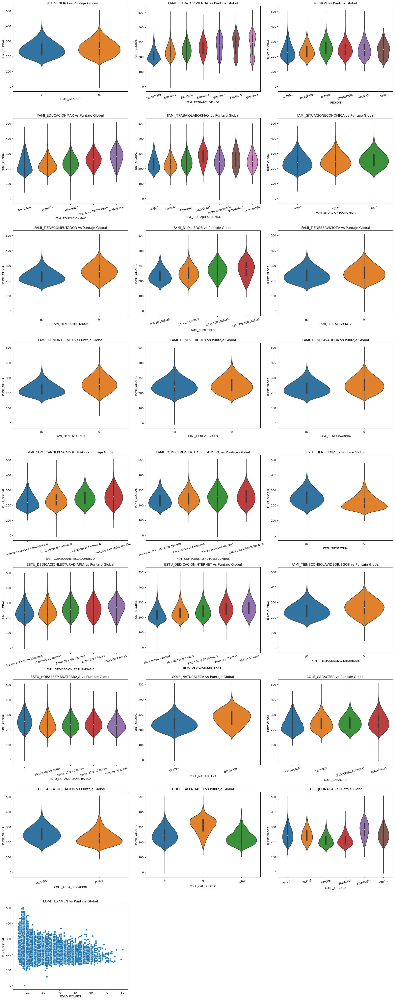

In [44]:
plt.figure(figsize=(20,50))
for i,var in enumerate(sociodemo):
    plt.subplot(9,3,i+1)
    if var in ['ESTU_GENERO','FAMI_ESTRATOVIVIENDA','REGION', 'FAMI_EDUCACIONMAX','FAMI_TRABAJOLABORMAX','FAMI_SITUACIONECONOMICA',
             'FAMI_TIENECOMPUTADOR','FAMI_NUMLIBROS','FAMI_TIENESERVICIOTV','FAMI_TIENEINTERNET','FAMI_TIENEVEHICULO',
             'FAMI_TIENELAVADORA','FAMI_COMECARNEPESCADOHUEVO','FAMI_COMECEREALFRUTOSLEGUMBRE','ESTU_TIENEETNIA','ESTU_DEDICACIONLECTURADIARIA',
             'ESTU_DEDICACIONINTERNET','FAMI_TIENECONSOLAVIDEOJUEGOS','ESTU_HORASSEMANATRABAJA','COLE_NATURALEZA','COLE_CARACTER',
             'COLE_AREA_UBICACION','COLE_CALENDARIO','COLE_JORNADA']:
        sns.violinplot(x=var, y='PUNT_GLOBAL', data=consolidado)
        plt.title(("{} vs Puntaje Global").format(var))
        plt.xticks(rotation=15)
        plt.tight_layout()
    if var in ['EDAD_EXAMEN']:
        sns.scatterplot(x=var, y='PUNT_GLOBAL', data=consolidado)
        plt.title(("{} vs Puntaje Global").format(var))       
fig.tight_layout()

Evaluando las caracteristicas demográficas vs los resultados gloables en al prueba tenemos lo siguiente:
* en relación al genero no parece haber diferencia entre las medias de la población sin embargo en el violin plot vemos que la barriga del genero másculino se concentra un poco arriba con respecto al genero femenino
* se evidencia que a medida que aumenta el estrato de la familia, aumenta el promedio del puntaje global
* parece que la zona Caribe y Amazonia tiene un promedio ligeramente menor al de las otras regiones
* que los padres tengan un titulo profesional o técnico incide en el promedio del puntaje
* que los padres trabajen como profesionales incide en el promedio del puntaje
* parece que la situacón económica no incide sobre el promedio del puntaje, sin emabrgo la barriga de los estudiantes donde la situación indica haber empeorado parace estar por encima de los que mejoraron
* que el estudiante tenga computador incide en el promedio del puntaje
* que la cantida de libros en el hogar incide en el promedio del puntaje
* parece que tener servicio de TV no incide en el puntaje sin embargo la barriga de los estudiantes que si tienen acceso a tv está un poco por encima de los que no
* que el estudiante tenga acceso a internet incide en el promedio del puntaje
* que la familia posea un vehículo parece no incidir en el promedio del puntaje
* parece que tener lavadora no incide en el puntaje sin embargo la barriga de los estudiantes que si tienen lavadora está un poco por encima de los que no
* que los estudiantes que comen 3 o mas veces Carne, Pescado o Huevo tienen mejor puntaje que los que no
* que los estudiantes que comen 3 o mas veces Cereales, Frutos o Legumbres tienen mejor puntaje que los que no
* se evidencia que los estudiantes que pertenecen a una etnia tiene por puntaje con respecto a los que no
* leer mas de 2 horas diarias mejora el promedio con respecto a la población que no lee por entretenimiento
* los estudiantes que navegan mas de 1 hora tienen mejor promedio con respecto a los que no
* los estudiantes que tiene video Juegos tiene  mejor promedio que los que no
* parece que los estudiantes que no trabajan tiene un promedio mejor a los que si
* se evidencia la diferencia del promedio de puntaje entre colegios oficiales y no oficiales
* parece que los estudiantes de colegios con enfoque académico tiene un promedio de puntaje mejor a los que no
* se evidencia que los estudiantes de zonas urbanas tiene mejor promedio que los que son rurales
* se evidencia que los estudiantes de calendario B tienen mejor promedio que los de otros calendarios
* se evidencia que los estudiantes de jornada compelta tienen mejor promedio, especialmente comparado con los estudiantes dejornada nocturna o sabatina 
* se evidencia que entre a mayor edad se presenta la prueba, disminuye el puntaje obtenido

### Gráficas Descriptivas vs Puntaje Individual

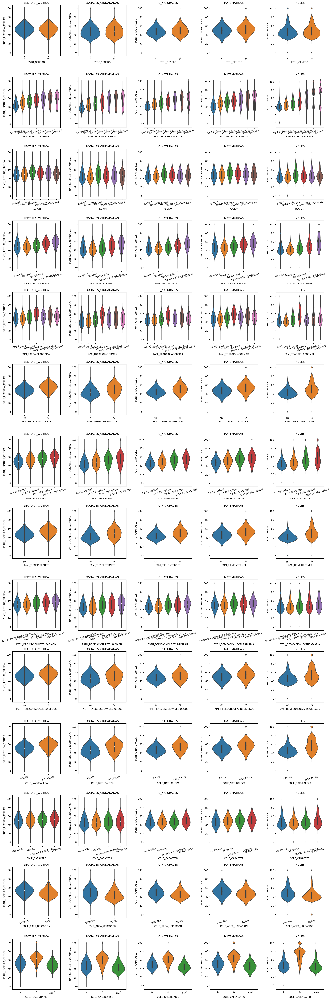

In [45]:
# plot the different variables:
categorias = ['ESTU_GENERO','FAMI_ESTRATOVIVIENDA', 'REGION','FAMI_EDUCACIONMAX','FAMI_TRABAJOLABORMAX','FAMI_TIENECOMPUTADOR',
              'FAMI_NUMLIBROS','FAMI_TIENEINTERNET','ESTU_DEDICACIONLECTURADIARIA','FAMI_TIENECONSOLAVIDEOJUEGOS','COLE_NATURALEZA',
              'COLE_CARACTER','COLE_AREA_UBICACION','COLE_CALENDARIO']

fig, ax = plt.subplots(len(categorias),5,figsize=(20,60))
for i,var in enumerate(categorias):
    if var in ['ESTU_GENERO','FAMI_ESTRATOVIVIENDA', 'REGION','FAMI_EDUCACIONMAX','FAMI_TRABAJOLABORMAX','FAMI_TIENECOMPUTADOR',
              'FAMI_NUMLIBROS','FAMI_TIENEINTERNET','ESTU_DEDICACIONLECTURADIARIA','FAMI_TIENECONSOLAVIDEOJUEGOS','COLE_NATURALEZA',
              'COLE_CARACTER','COLE_AREA_UBICACION','COLE_CALENDARIO']:
        sns.violinplot(x=var, y='PUNT_LECTURA_CRITICA', data=consolidado,ax = ax[i,0])
        ax[i,0].set_title(("LECTURA_CRITICA"))
        ax[i,0].tick_params('x',labelrotation=15)
        sns.violinplot(x=var, y='PUNT_SOCIALES_CIUDADANAS', data=consolidado,ax = ax[i,1])
        ax[i,1].set_title(("SOCIALES_CIUDADANAS"))
        ax[i,1].tick_params('x',labelrotation=15)
        sns.violinplot(x=var, y='PUNT_C_NATURALES', data=consolidado,ax = ax[i,2])
        ax[i,2].set_title(("C_NATURALES"))
        ax[i,2].tick_params('x',labelrotation=15)
        sns.violinplot(x=var, y='PUNT_MATEMATICAS', data=consolidado,ax = ax[i,3])
        ax[i,3].set_title(("MATEMATICAS"))
        ax[i,3].tick_params('x',labelrotation=15)
        sns.violinplot(x=var, y='PUNT_INGLES', data=consolidado,ax = ax[i,4])
        ax[i,4].set_title(("INGLES"))
        ax[i,4].tick_params('x',labelrotation=15)
plt.tight_layout()

revisando algunas variables sociodemográficas con respecto a los resultados por las principales áreas vemos:
* parece no existir diferencia en los resultados entre el género Femenino y Masculino a excepción de una pequeña diferencia en matemáticas
* se evidencia una diferencia marcada de los promedios de resultados con respecto al estrato
* con respecto a las regiones, la zona andina resalta en Matemáticas e Inglés
* con respecto a la educación de los padres, que sean profesionales parece tener incidencia en lso resutlados en inglés y Matemáticas
* con respecto a la labor d elos padres, que sean profesionales o empresarios parece tener incidencia en los promedios d elos resultados
* se evidencia diferencia en todos los promedios de resultados con respecto a la población de estudiantes que tienen computadores con los que no 
* se evidencia diferencia en todos los promedios de resultados con respecto a la cantidad de libros en el hogar
* se evidencia diferencia en todos los promedios de resultados con respecto a la población de estudiantes que tienen Internet con los que no
* parece existir diferencia el promedio de resultados de Lectura crítica, Ciencias Sociales e Ingles a medida que se aumentan las horas de lectura
* parece existir diferencia el promedio de resultados de Ciencias Sociales, Naturales, Matemáticas e Ingles entre estudiantes que poseen consolas de videojuegos con respecto a los que no

### Análisis de Correlación entre variables

La mayoria de las variables del dataset son categoricas, por lo que realizaremos un test de V Crammers (que compara por medio de Chi2) para evaluar la correlación entre este tipo de variables.

Para variables numpericas no realizaremos análisis pues solo nos quedaremos con el puntaje global y la edad.

In [46]:
# cambiamos el tipo de dato de Object a Category
evaluar = consolidado.columns
for i in evaluar:
    if consolidado[i].dtypes == 'O':
        consolidado[i] = consolidado[i].astype('category')
# selección solo de las variables categoricas
categoricos = consolidado.select_dtypes(include=['category'])

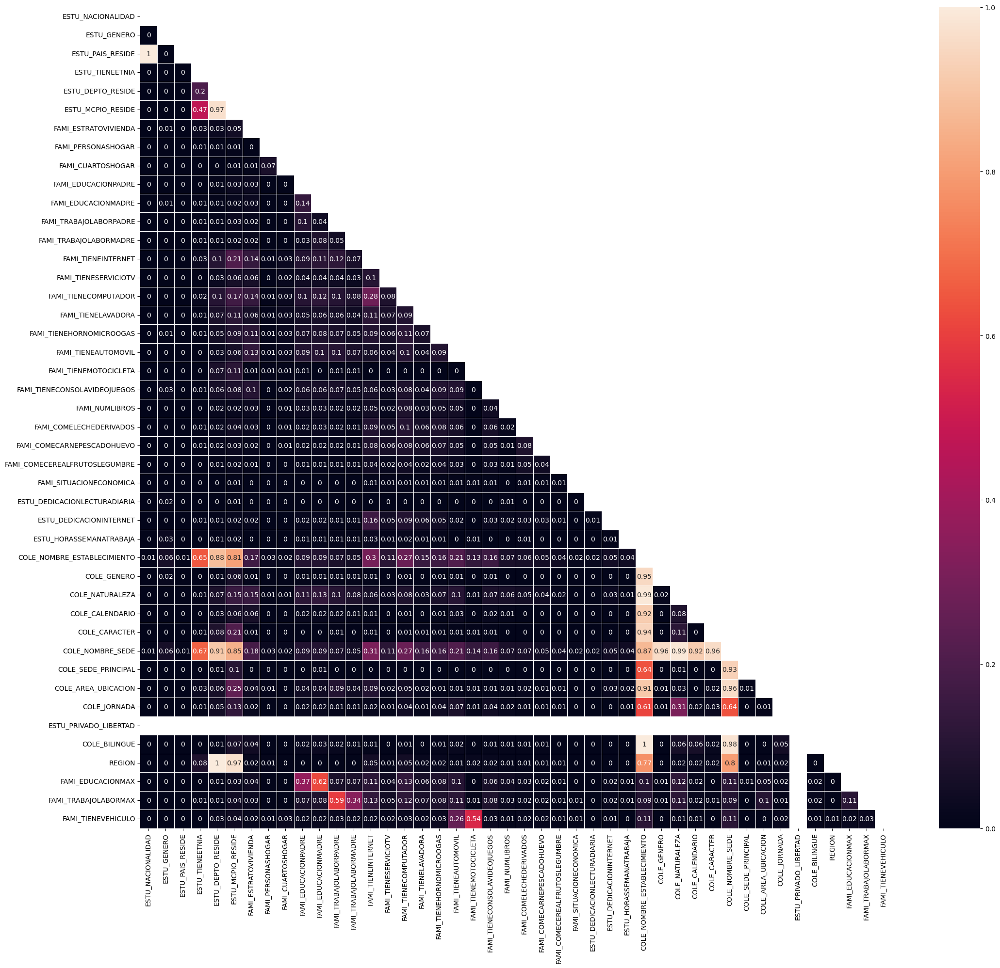

In [47]:
# Definición de la función para  evaluar la V de Cramers:
def cramers_V(var1,var2) :
    crosstab =np.array(pd.crosstab(var1,var2, rownames=None, colnames=None)) # Crear tablas cross table entre variables
    stat = chi2_contingency(crosstab)[0] # correr test de Chi2 y nos quedamos con el resultado
    obs = np.sum(crosstab) # determinamos el número de observaciones
    mini = min(crosstab.shape)-1 # tomamos los valores minimos entre columnas y filas
    return (stat/(obs*mini))

# Construimos una matriz para pobvlar los datos:
filas= []
for var1 in categoricos:
    columnas = []
    for var2 in categoricos :
        cramers =cramers_V(categoricos[var1], categoricos[var2]) # realizamos el test de Cramer's V
        columnas.append(round(cramers,2)) 
    filas.append(columnas)

cramers_results = np.array(filas)
cramers = pd.DataFrame(cramers_results, columns = categoricos.columns, index =categoricos.columns)

# generamos un Plot con el análisis de asociación entre las variables categóricas
fig, ax = plt.subplots(figsize=(25,22)) 
matrix = np.triu(np.ones_like(cramers, dtype=bool))
hm = sns.heatmap(data=cramers,annot=True,linewidths=.5,mask=matrix ,ax=ax)

plt.show(hm)

podemos ver que existe una alta correlación entre:
* Nacionalidad del estudiante y País de residencia
* Entre la region, el departamento y municipio de residencia
* Nombre del colegio y Sede con el genero del colegio, la Naturaleza, el calendario, el Caracter, área de ubicación, si es Bilingue, la región del estudiante y la Etnia

para efectos del modelo de ML y nuestro análisis eliminaremos las siguientes columnas:

In [48]:
eliminar = ['ESTU_PAIS_RESIDE','ESTU_MCPIO_RESIDE','COLE_NOMBRE_SEDE','COLE_NOMBRE_ESTABLECIMIENTO',
            'COLE_SEDE_PRINCIPAL','ESTU_FECHANACIMIENTO','PERIODO']
consolidado.drop(eliminar, axis=1, inplace=True)

In [49]:
# para efectos de no volver a procesar todo el dataset por si tenemos que reiniciar el Kernel, exportaremos las bases para 
# poderlas cargar como csv
#consolidado.to_csv('consolidado.csv',index = False, encoding= 'utf-8')
#data_ml.to_csv('data_ml.csv',index = False, encoding= 'utf-8')

#### Conclusiones

Con respecto a las caracteristicas observadas se evidencia que el estrato, el nivel de estudio y labor de los padres, el acceso a recursos como internet, libros y computadora, la alimentación, pertenecer a una etnia, el calendario del colegio, el enfoque académico del colegio, la Naturaleza del colegio, la Ubicación del colegio y si el estudiante trabaja inciden en los promedios de resultados gloables.

Sin embargo se considera para postumas evaluaciones si interacciones como poseer computadora, acceso a internet y la alimentación están contenidas dentro de la caracterización del estrato.

## Fase 3: abordar relación variables-desempeño a través de un modelo

En esta fase propondrás, implementarás y reportarás el desempeño de uno o más modelos (al menos uno predictivo) que busquen explicar las relaciones entre factores sociodemográficos y el desempeño en la prueba. Además, concluirás con respecto a la validez de al menos un modelo y los posibles hallazgos que se podrían reportar para el *stakeholder*.

Pautas generales:

* Seleccionar variables y proponer modelos acordes a estas y al contexto del problema.
* Utilizar librerías especializadas (ej., `statsmodels`, `sklearn`, etc.) para indagar sobre los aspectos que contribuyen al éxito de los estudiantes. Los módulos correspondientes a regresión lineal y regresión logística pueden ser útiles.
* Asegurar el cumplimiento de los supuestos y buenas prácticas de cada modelo.
* Utilizar las métricas de evaluación de desempeño (disponibles en las librerías especilizadas), para concluir sobre la validez de los modelos propuestos.

Preguntas guía:

* ¿Existe algún sub-conjunto de variables socio-demográficas que explique razonablemente bien el desempeño de los estudiantes en la prueba?

In [50]:
# cargamos los datos desde csv en caso de reiniciar el kernel
#consolidado = pd.read_csv('consolidado.csv')
#data_ml = pd.read_csv('data_ml.csv')

**Para esta fase exploratorio iniciaremos con un modelo de Regresion Lineal y Otro de Logistica, para posteriormente explorar por medio de otros modelos el performance del que mejor explique los resultados gloables por parte de los estudiantes**

In [51]:
# tomamos del dataset consolidado las variables de interes, este paso nos sirve para cambiar las variabels de exploración
variables_interes = ['PUNT_GLOBAL', # variable de interes
                     'ESTU_GENERO','EDAD_EXAMEN','REGION','ESTU_DEDICACIONLECTURADIARIA', # del estudiante
                     'ESTU_DEDICACIONINTERNET','ESTU_HORASSEMANATRABAJA','ESTU_TIENEETNIA',
                     'FAMI_ESTRATOVIVIENDA','FAMI_EDUCACIONMAX','FAMI_TRABAJOLABORMAX','FAMI_TIENEINTERNET', # familiares
                     'FAMI_TIENECOMPUTADOR','FAMI_TIENECONSOLAVIDEOJUEGOS','FAMI_NUMLIBROS','FAMI_COMECARNEPESCADOHUEVO',
                     'FAMI_COMECEREALFRUTOSLEGUMBRE','FAMI_SITUACIONECONOMICA',
                     'FAMI_PERSONASHOGAR','FAMI_CUARTOSHOGAR',
                     'COLE_NATURALEZA','COLE_CALENDARIO','COLE_CARACTER','COLE_AREA_UBICACION', # colegio
                     'COLE_JORNADA','COLE_BILINGUE']
# filtramos las variables de interes
data_ml = consolidado[variables_interes]

### Regresión Lineal Múltiple

In [52]:
# creamos X y y 
y = data_ml.iloc[:,0]
X = data_ml.drop(data_ml.columns[0],axis=1)

# realizamos Split Train test de nuestro dataset seleccionado 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

print('Original dataset shape:',data_ml.shape)
print('Train dataset shape:', X_train.shape)
print('Test dataset shape:', X_test.shape)

Original dataset shape: (952574, 26)
Train dataset shape: (666801, 25)
Test dataset shape: (285773, 25)


In [53]:
# realizamos proceso de encoding y standarización de datos numéricos
X_cols = X.select_dtypes(include=['category']).columns

X_train_e = pd.get_dummies(X_train,columns=X_cols,drop_first=True)
X_test_e = pd.get_dummies(X_test,columns=X_cols,drop_first=True)
X_train_e['EDAD_EXAMEN'] = (X_train_e['EDAD_EXAMEN'] - X_train_e['EDAD_EXAMEN'].min())/(X_train_e['EDAD_EXAMEN'].max() - X_train_e['EDAD_EXAMEN'].min())
X_test_e['EDAD_EXAMEN'] = (X_test_e['EDAD_EXAMEN'] - X_test_e['EDAD_EXAMEN'].min())/ (X_test_e['EDAD_EXAMEN'].max() - X_test_e['EDAD_EXAMEN'].min())
y_train_e = (y_train - y_train.min())/ (y_train.max() - y_train.min())
y_test_e = (y_test - y_test.min())/ (y_test.max() - y_test.min())

In [54]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 666801 entries, 648193 to 125310
Data columns (total 25 columns):
 #   Column                         Non-Null Count   Dtype   
---  ------                         --------------   -----   
 0   ESTU_GENERO                    666801 non-null  category
 1   EDAD_EXAMEN                    666801 non-null  float64 
 2   REGION                         666801 non-null  category
 3   ESTU_DEDICACIONLECTURADIARIA   666801 non-null  category
 4   ESTU_DEDICACIONINTERNET        666801 non-null  category
 5   ESTU_HORASSEMANATRABAJA        666801 non-null  category
 6   ESTU_TIENEETNIA                666801 non-null  category
 7   FAMI_ESTRATOVIVIENDA           666801 non-null  category
 8   FAMI_EDUCACIONMAX              666801 non-null  category
 9   FAMI_TRABAJOLABORMAX           651708 non-null  category
 10  FAMI_TIENEINTERNET             666801 non-null  category
 11  FAMI_TIENECOMPUTADOR           666801 non-null  category
 12  FAMI_TIENEC

In [55]:
# corremos el modelo de regresiónlineal multiple
X_train = sm.add_constant(X_train_e, prepend=True)
LM = sm.OLS(endog=y_train_e, exog=X_train,)
LM = LM.fit()
print(LM.summary())

                            OLS Regression Results                            
Dep. Variable:            PUNT_GLOBAL   R-squared:                       0.366
Model:                            OLS   Adj. R-squared:                  0.366
Method:                 Least Squares   F-statistic:                     5356.
Date:                Mon, 12 Dec 2022   Prob (F-statistic):               0.00
Time:                        16:11:59   Log-Likelihood:             7.4001e+05
No. Observations:              666801   AIC:                        -1.480e+06
Df Residuals:                  666728   BIC:                        -1.479e+06
Df Model:                          72                                         
Covariance Type:            nonrobust                                         
                                                                coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------

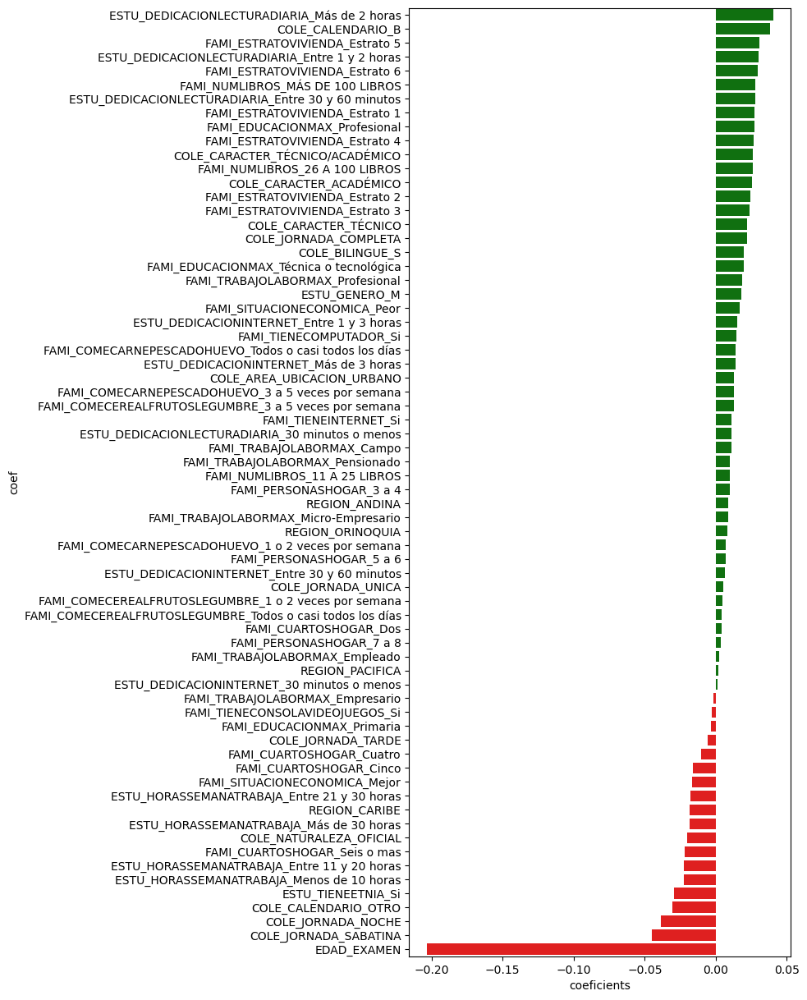

In [56]:
# creamos una ormula para visualizar los coeficientes relevantes y su peso de los que no
def coef_reg_statsmodels(model):
    para = model.params
    pval = model.pvalues
    df = pd.concat([para,pval],axis=1).reset_index().rename(columns={'index':'coef',0:'coeficients',1:'P-values'})
    df.drop(df.index[0], inplace=True)
    
    df = df[df['P-values']< 0.05]
    df = df.sort_values('coeficients',ascending=False)
    
    f, ax = plt.subplots(figsize=(6, 15))
    
    colors = ['g' if c >= 0 else 'r' for c in df['coeficients']]
    sns.barplot(x='coeficients',y='coef',data=df, palette=colors,orient = 'h') 
    

coef_reg_statsmodels(LM)

In [57]:
# variables no relevantes
def coef_no_rel_statsmodels(model):
    para = model.params
    pval = model.pvalues
    df = pd.concat([para,pval],axis=1).reset_index().rename(columns={'index':'coef',0:'coeficients',1:'P-values'})
    df.drop(df.index[0], inplace=True)
    df = df[df['P-values']>= 0.05]
    df = df.sort_values('coeficients',ascending=False)

    return list(df['coef'])

coef_no_rel_statsmodels(LM)

['FAMI_EDUCACIONMAX_Bachillerato',
 'FAMI_PERSONASHOGAR_9 o más',
 'FAMI_CUARTOSHOGAR_Tres',
 'REGION_OTRA']

#### Evaluación de residuos

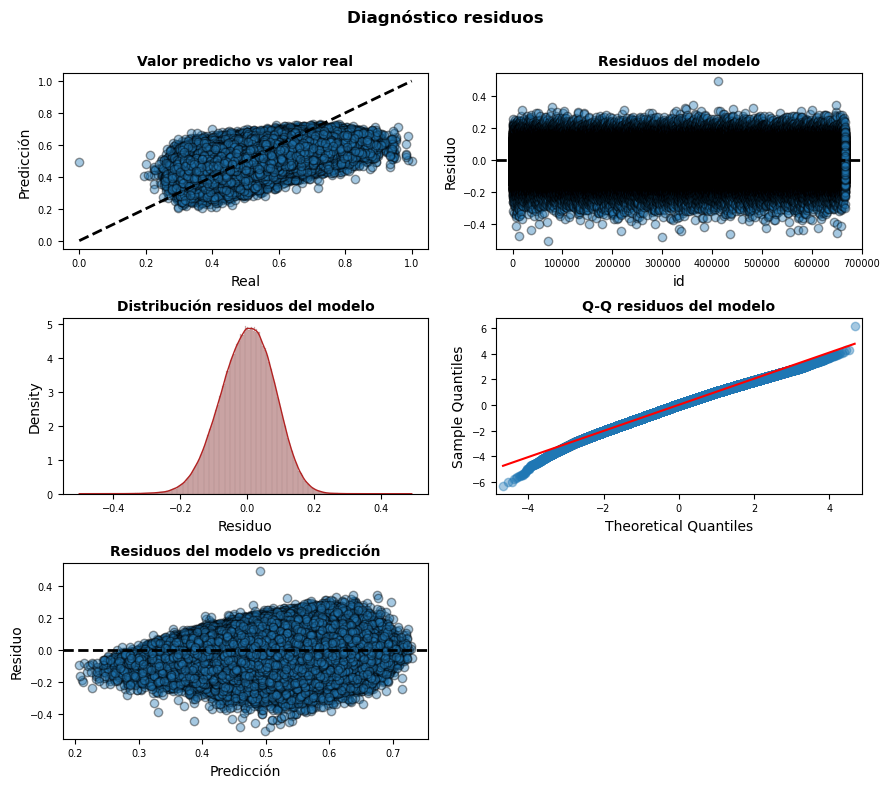

In [58]:
prediccion_train = LM.predict(exog = X_train)
residuos_train   = prediccion_train - y_train_e

# Gráficos
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(9, 8))

axes[0, 0].scatter(y_train_e, prediccion_train, edgecolors=(0, 0, 0), alpha = 0.4)
axes[0, 0].plot([y_train_e.min(), y_train_e.max()], [y_train_e.min(), y_train_e.max()],'k--', color = 'black', lw=2)
axes[0, 0].set_title('Valor predicho vs valor real', fontsize = 10, fontweight = "bold")
axes[0, 0].set_xlabel('Real')
axes[0, 0].set_ylabel('Predicción')
axes[0, 0].tick_params(labelsize = 7)

axes[0, 1].scatter(list(range(len(y_train_e))), residuos_train,edgecolors=(0, 0, 0), alpha = 0.4)
axes[0, 1].axhline(y = 0, linestyle = '--', color = 'black', lw=2)
axes[0, 1].set_title('Residuos del modelo', fontsize = 10, fontweight = "bold")
axes[0, 1].set_xlabel('id')
axes[0, 1].set_ylabel('Residuo')
axes[0, 1].tick_params(labelsize = 7)

sns.histplot(data = residuos_train,stat = "density",kde = True,line_kws= {'linewidth': 1},color = "firebrick",alpha = 0.3,ax = axes[1, 0])
axes[1, 0].set_title('Distribución residuos del modelo', fontsize = 10, fontweight = "bold")
axes[1, 0].set_xlabel("Residuo")
axes[1, 0].tick_params(labelsize = 7)

sm.qqplot(residuos_train,fit = True,line = 'q',ax = axes[1, 1], color = 'firebrick',alpha = 0.4,lw    = 2)
axes[1, 1].set_title('Q-Q residuos del modelo', fontsize = 10, fontweight = "bold")
axes[1, 1].tick_params(labelsize = 7)
axes[2, 0].scatter(prediccion_train, residuos_train,edgecolors=(0, 0, 0), alpha = 0.4)
axes[2, 0].axhline(y = 0, linestyle = '--', color = 'black', lw=2)
axes[2, 0].set_title('Residuos del modelo vs predicción', fontsize = 10, fontweight = "bold")
axes[2, 0].set_xlabel('Predicción')
axes[2, 0].set_ylabel('Residuo')
axes[2, 0].tick_params(labelsize = 7)

# Se eliminan los axes vacíos
fig.delaxes(axes[2,1])

fig.tight_layout()
plt.subplots_adjust(top=0.9)
fig.suptitle('Diagnóstico residuos', fontsize = 12, fontweight = "bold");

El modelo inicial de regresión Lineal nos permite ver que tiene un bajo ajuste al tener un R2 del 36.6% por lo que no es un buen modelo para predecir la variación en los resultados Globales de las pruebas saber 11. Dentro del análisis gráfico podemos evidenciar que la predicción no se ajusta a los valores esperados, que tenemos unas coals largas a la izquierda de la distribución y que los residuos vs los de la predicción aparentemente siguen un patrón con respecto a alguna transformación lineal que pudiera realizarce para mejorar el poder predictivo. 

#### Otros Modelos de Reg Lineal de ML (Scikit learn)

In [59]:
# 3. Definimos el / los Modelos
models_estimator = [LinearRegression(),
                    Ridge(alpha=1),
                    Lasso(alpha=1),
                    SGDRegressor(max_iter=1000, tol=1e-3)]

models_names = ['LM','Ridge','Lasso','SGD']
  
scores_models = []
for model, name in zip(models_estimator, models_names):
    model.fit(X_train_e, y_train)
    predictions = model.predict(X_test_e)
    scores_models.append((name, r2_score(y_test, predictions),explained_variance_score(y_test, predictions),
                          mean_absolute_error(y_test, predictions)))

# Crear Dataframe con los resultados
scores_df = pd.DataFrame(scores_models, columns=['Model', 'R2','Variance Score','MSE'])
scores_df.sort_values(by=['R2'], ascending=False, inplace=True)
scores_df

,Model,R2,Variance Score,MSE
1,Ridge,0.368257,0.368294,32.036464
0,LM,0.368257,0.368294,32.036481
3,SGD,0.366879,0.367681,32.034060
2,Lasso,0.271507,0.271529,34.739544


Podemos ver que entre todos los modelos de regresión propuestos el de Ridge es el que mejor perfoance tuvo con respecto al R2, sinembargo vemos que su poder de predicción sobre la varianza del puntaje global es muy bajo, por lo que se sugiere explorar otros tipos de modelos como Clasificación

### Clasificación 

Para definir los modelos de Clasificación, procederemos a generar una segmentación en rangos para nuestra variable de interes. la prueba saber 11 tiene un máximo de 500 puntos, por lo que nos interesa identificar las caracteristicas de aquellos estudiantes que logran al menos el 75% del puntaje global (mas de 375 puntos)

In [60]:
# codificamos nuestras y aprovechando que las tenemos en termino de 0 a 1
y_train_c = y_train_e.apply(lambda x: 1 if x > 0.75 else 0)
y_test_c = y_test_e.apply(lambda x: 1 if x > 0.75 else 0)

In [61]:
Logit = sm.Logit(endog=y_train_c, exog=X_train_e,)
Logit = Logit.fit()
print(Logit.summary())

         Current function value: 0.035373
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:            PUNT_GLOBAL   No. Observations:               666801
Model:                          Logit   Df Residuals:                   666729
Method:                           MLE   Df Model:                           71
Date:                Mon, 12 Dec 2022   Pseudo R-squ.:                  0.2499
Time:                        16:12:30   Log-Likelihood:                -23587.
converged:                      False   LL-Null:                       -31443.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                                                coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------------
EDAD_EXAMEN                                       

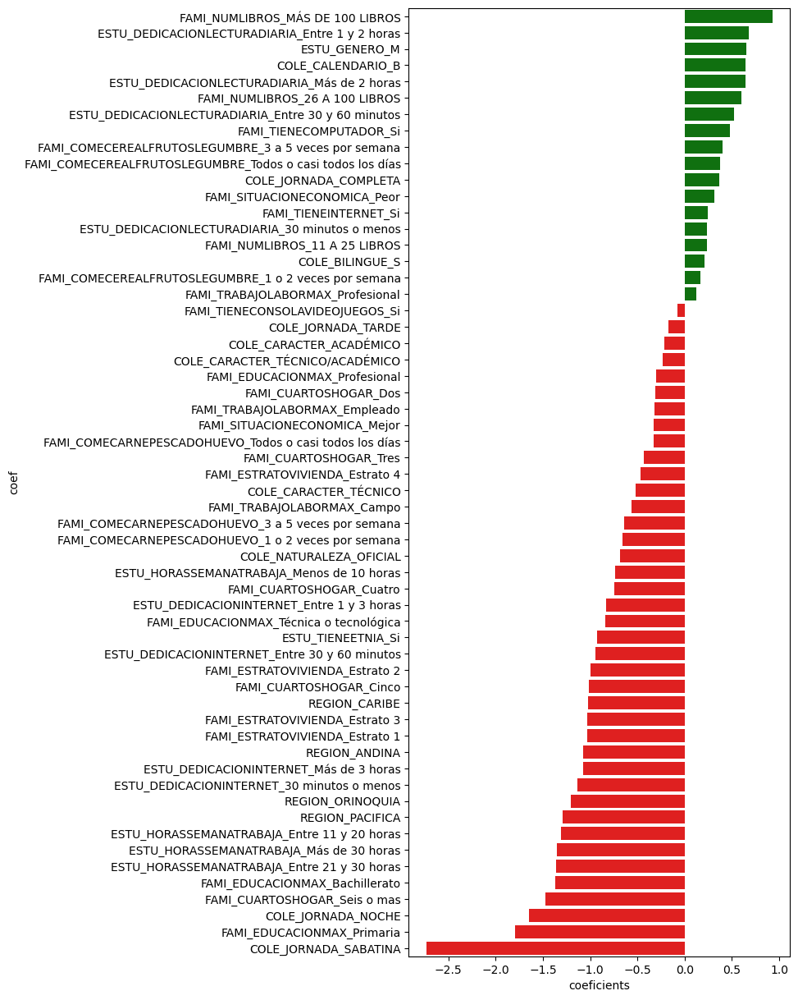

In [62]:
# evaluación de coeficientes
coef_reg_statsmodels(Logit)

In [63]:
# coeficientes que no son relevantes
coef_no_rel_statsmodels(Logit)

['COLE_AREA_UBICACION_URBANO',
 'FAMI_PERSONASHOGAR_5 a 6',
 'FAMI_PERSONASHOGAR_3 a 4',
 'COLE_JORNADA_UNICA',
 'FAMI_TRABAJOLABORMAX_Micro-Empresario',
 'FAMI_TRABAJOLABORMAX_Empresario',
 'FAMI_TRABAJOLABORMAX_Pensionado',
 'FAMI_PERSONASHOGAR_9 o más',
 'FAMI_PERSONASHOGAR_7 a 8',
 'FAMI_ESTRATOVIVIENDA_Estrato 6',
 'FAMI_ESTRATOVIVIENDA_Estrato 5',
 'COLE_CALENDARIO_OTRO',
 'REGION_OTRA']

In [64]:
# generamos las métricas para evaluar un modelo de clasificación
model=LogisticRegression()
model.fit(X_train_e, y_train_c)
test_data_prediction = model.predict(X_test_e)
accuracy = accuracy_score(y_test_c, test_data_prediction)
print('Accuracy score of the', model, ' = ',accuracy)

Accuracy score of the LogisticRegression()  =  0.9958813463833183


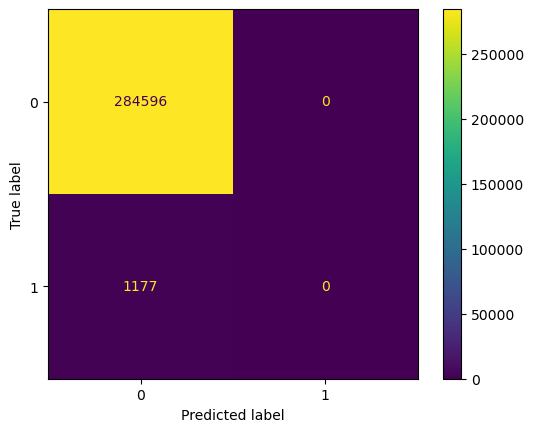

In [65]:
y_pred = model.predict(X_test_e)
confusion_matrix(y_test_c, y_pred)
plot_confusion_matrix(model, X_test_e, y_test_c)  

In [66]:
print(classification_report(y_test_c, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    284596
           1       0.00      0.00      0.00      1177

    accuracy                           1.00    285773
   macro avg       0.50      0.50      0.50    285773
weighted avg       0.99      1.00      0.99    285773



podemos observar que el modelo de regresión logistica no es bueno al tener problemas de convergencia, y que con respecto a nuestra variable de interes (1) no logra clasificarlos. Esto obedece  a que tenemos la clase 1 fuertemente desbalanceada.

#### Otros Modelos de Clasificación (Scikit learn)

## Fase 4

### Desarrollar una herramienta interactiva de análisis

En esta fase desarrollarás, a partir de alguno de los análisis realizados, una herramienta interactiva que sea relevante en el contexto del problema, acompañada de las instrucciones necesarias para que un usuario la pueda utilizar.

Preguntas guía:

* ¿Cuál o cuáles preguntas podrá hacerle el usuario a la herramienta y cómo aporta la respuesta al análisis?
* ¿Qué aprendizajes clave puede explorar u obtener el usuario con esta herramienta?

In [67]:
import panel as pn
import plotly.graph_objects as go
pn.extension("plotly")

In [68]:
titulo = '# Dashboard Pruebas Saber 11 (20 - 21)'

In [69]:
# selecciones
seleccion1 = pn.widgets.RadioButtonGroup(name="resultado", options=['PUNT_GLOBAL','PUNT_INGLES','PUNT_SOCIALES_CIUDADANAS','PUNT_C_NATURALES','PUNT_MATEMATICAS','PUNT_LECTURA_CRITICA'])
seleccion2 = pn.widgets.Select(name="Variables",options= variables_interes[1:])
#seleccion3 = pn.widgets.IntSlider(name='Puntaje Mínimo', start=0, end=500, step=10, value=0)
#seleccion = pn.widgets.CrossSelector(name="Departamento",options=list(consolidado['ESTU_DEPTO_RESIDE'].unique().sort_values()))

In [70]:
# traemos de plotly subplots
from plotly.subplots import make_subplots
import plotly.express as px

# Le decimos a panel que nuestro gráfico depende de cambios en el párametro seleccion.
@pn.depends(seleccion1.param.value,seleccion2.param.value)

# Definimos la función que se encarga de la interactividad del tablero de control.
def funcion_interactiva(seleccion1,seleccion2):
    valor = consolidado.filter(like=seleccion1)
    datos = consolidado.filter(like=seleccion2)
    merged = pd.merge(datos,valor,left_index=True, right_index=True)
    merged = merged.sort_values(by = seleccion2)
    
    fig1 = px.box(merged, x=merged.columns[0], y=merged.columns[1], color=merged.columns[0])

    return  fig1

# Le decimos a panel que nuestro gráfico depende de cambios en el párametro seleccion.
@pn.depends(seleccion1.param.value,seleccion2.param.value)

def funcion_interactiva2(seleccion1,seleccion2):
    valor = consolidado.filter(like=seleccion1)
    datos = consolidado.filter(like=seleccion2)
    merged = pd.merge(datos,valor,left_index=True, right_index=True)
    merged = merged.sort_values(by = seleccion2)
    
    fig2 = px.pie(merged, names=merged.columns[0], values=merged.columns[1])

    return  fig2

In [71]:
# Declaramos el tablero de control.
tablero_control = pn.Column(titulo, seleccion1,seleccion2,pn.Row(funcion_interactiva,funcion_interactiva2))

In [72]:
# Finalmente, mostramos el tablero de control.
tablero_control.servable()

Column
    [0] Markdown(str)
    [1] RadioButtonGroup(name='resultado', options=['PUNT_GLOBAL', ...], value='PUNT_GLOBAL')
    [2] Select(name='Variables', options=['ESTU_GENERO', ...], value='ESTU_GENERO')
    [3] Row
        [0] ParamFunction(function)
        [1] ParamFunction(function)

In [73]:
# traemos de plotly subplots
from plotly.subplots import make_subplots


# Le decimos a panel que nuestro gráfico depende de cambios en el párametro seleccion.
@pn.depends(seleccion1.param.value,seleccion2.param.value)

# Definimos la función que se encarga de la interactividad del tablero de control.
def funcion_interactiva3(seleccion1,seleccion2):
    valor = consolidado.filter(like=seleccion1)
    datos = consolidado.filter(like=seleccion2)
    merged = pd.merge(datos,valor,left_index=True, right_index=True)
    merged = merged.sort_values(by = seleccion2)
    
    fig = make_subplots(rows=1, cols=2,subplot_titles=('a','b'))
    
    #fig.add_trace()

    return  fig


In [74]:
# Declaramos el tablero de control.
tablero_control2 = pn.Column(titulo, seleccion1,seleccion2,funcion_interactiva3)

In [75]:
# Finalmente, mostramos el tablero de control.
tablero_control2.servable()

Column
    [0] Markdown(str)
    [1] RadioButtonGroup(name='resultado', options=['PUNT_GLOBAL', ...], value='PUNT_GLOBAL')
    [2] Select(name='Variables', options=['ESTU_GENERO', ...], value='ESTU_GENERO')
    [3] ParamFunction(function)